# Árvore de Decisão

## Explicação

Algoritmo de classificação utilizado para realizar predições de categorias ou classes

### Algoritmo de classificação

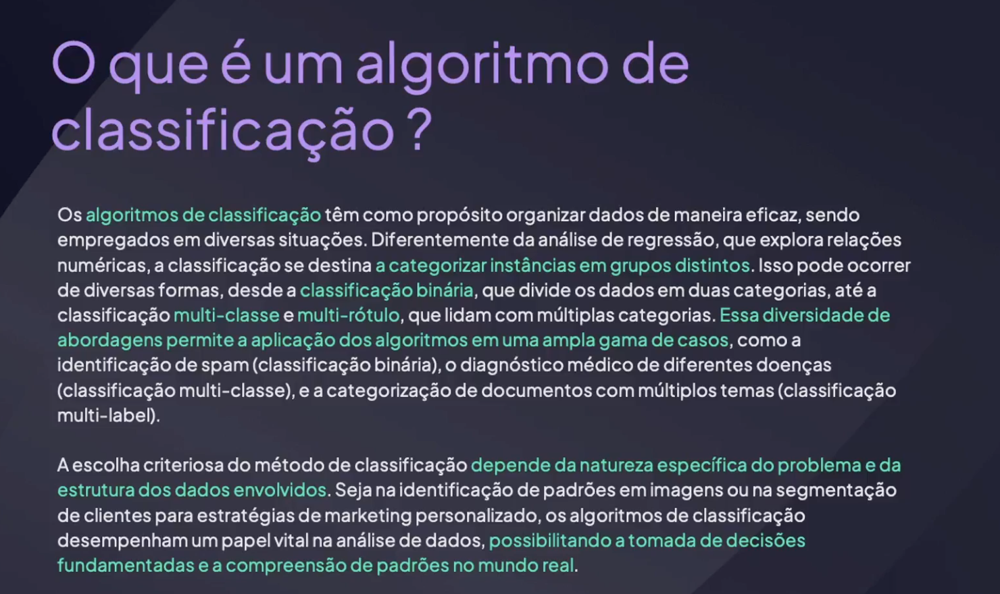

### Tipos de algoritmo de classificação

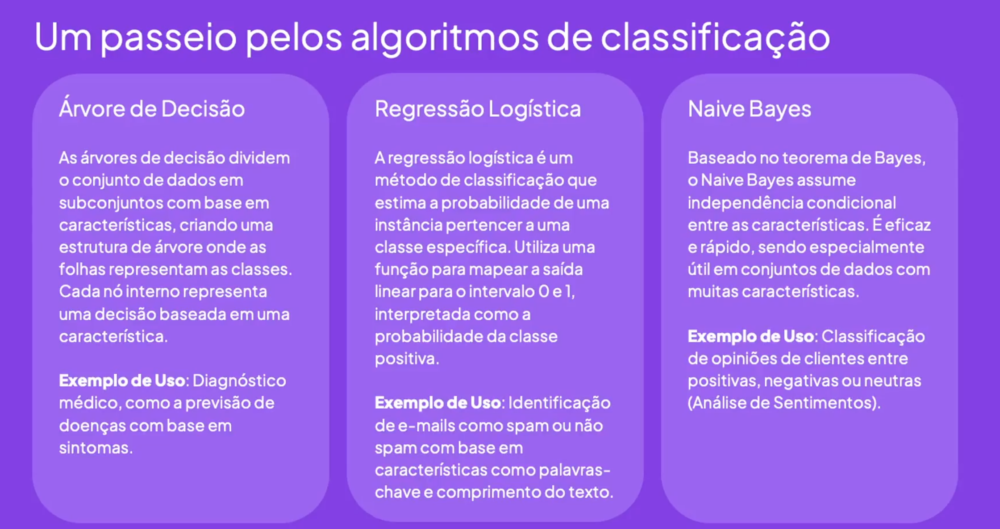

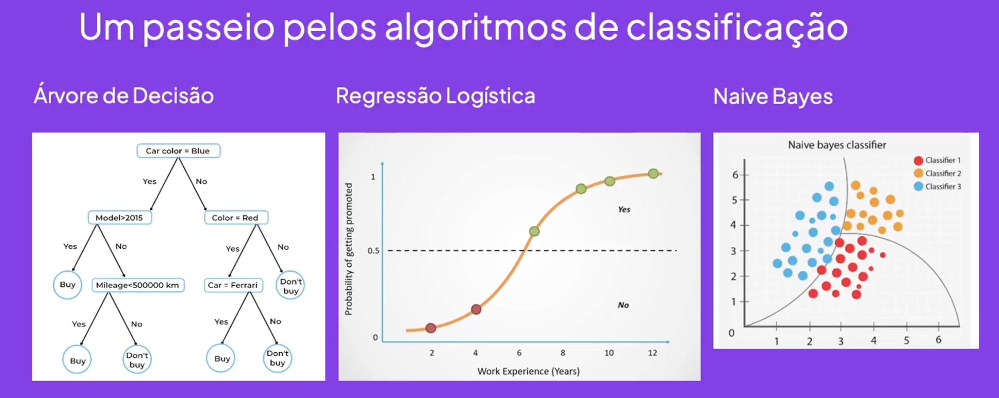

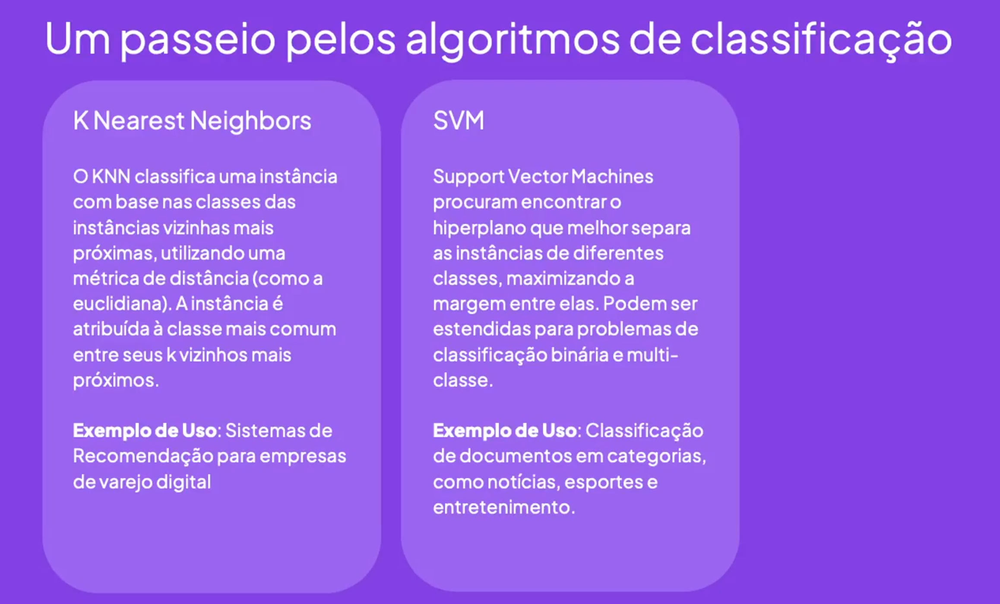

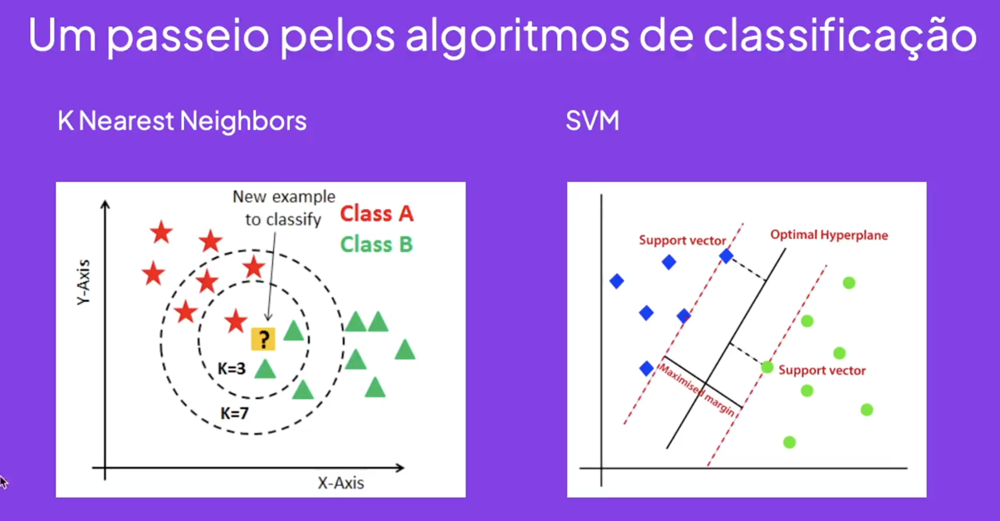

### Árvore de decisão

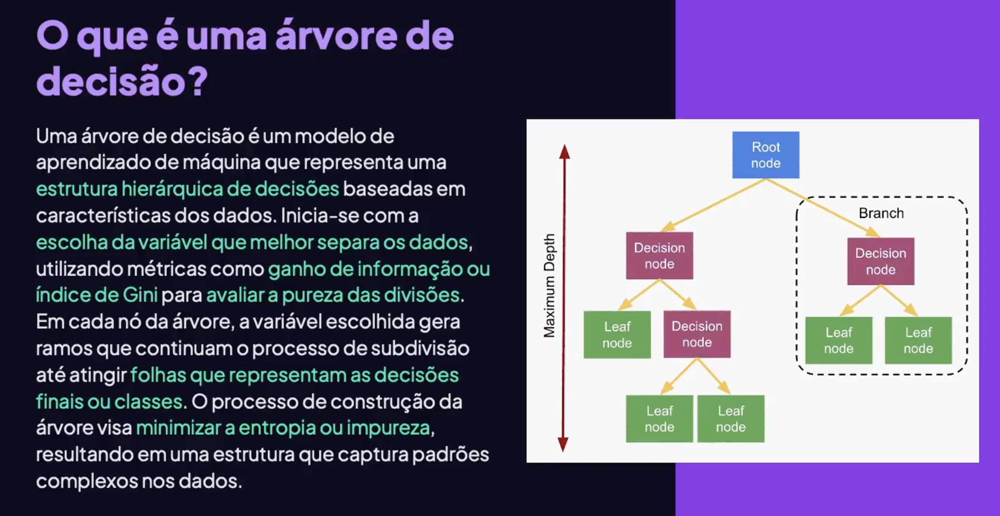

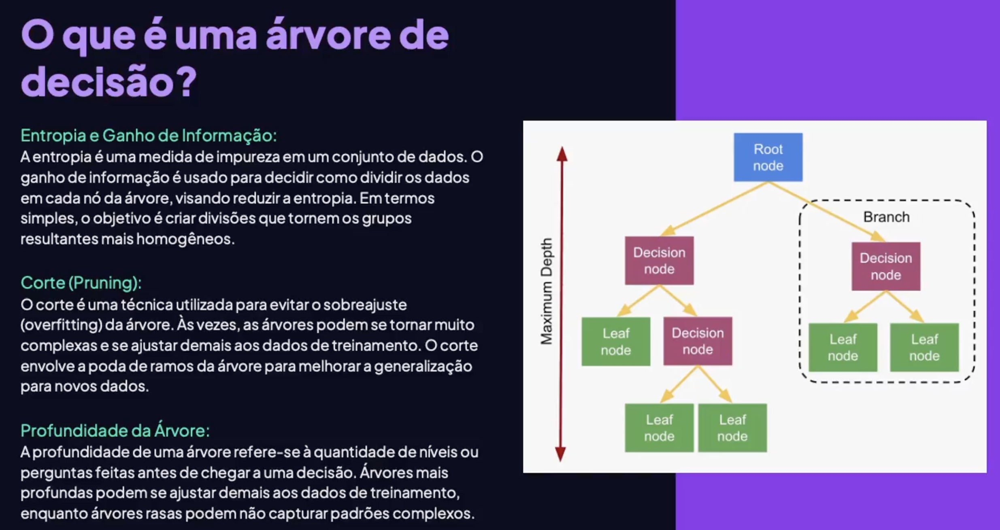

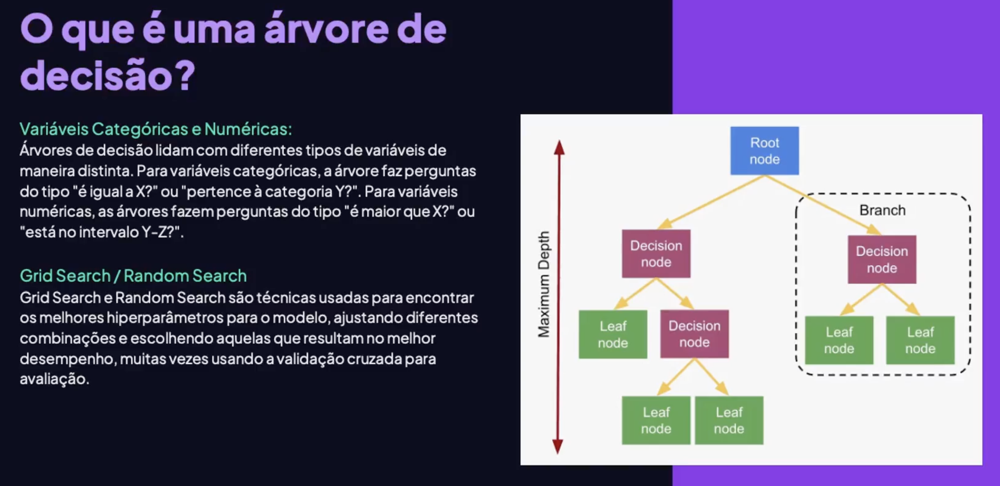

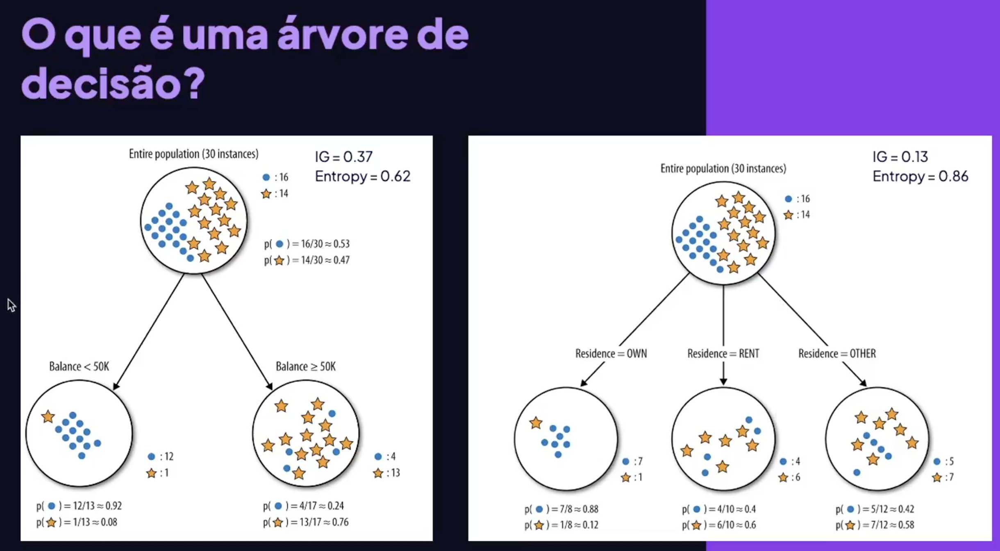

## Importações

`pipenv install pandas plotly matplotlib pingouin==0.5.5 nbformat ipykernel scikit-learn optuna ipywidgets gradio --python 3.9`

In [1]:
# EDA
import pandas as pd
import pingouin as pg
import plotly.express as px
import plotly.figure_factory as ff
import matplotlib.pyplot as plt

In [2]:
# Machine Learning
from sklearn.model_selection import cross_validate, StratifiedKFold, cross_val_predict, cross_val_score
from sklearn.preprocessing import OneHotEncoder
from sklearn.compose import ColumnTransformer
from sklearn.pipeline import Pipeline
from sklearn.impute import SimpleImputer
from sklearn.tree import DecisionTreeClassifier, plot_tree
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay, classification_report

In [3]:
# Otimização de Hiperparâmetros do Modelo
import optuna

In [4]:
df_segmento = pd.read_csv('./dataset/segmento_clientes.csv')

## EDA

### Análise dos dados

In [5]:
# Estrutura do dataset
df_segmento.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 500 entries, 0 to 499
Data columns (total 7 columns):
 #   Column                  Non-Null Count  Dtype  
---  ------                  --------------  -----  
 0   atividade_economica     500 non-null    object 
 1   faturamento_mensal      500 non-null    float64
 2   numero_de_funcionarios  500 non-null    int64  
 3   localizacao             500 non-null    object 
 4   idade                   500 non-null    int64  
 5   inovacao                500 non-null    int64  
 6   segmento_de_cliente     500 non-null    object 
dtypes: float64(1), int64(3), object(3)
memory usage: 27.5+ KB


In [6]:
# Visualizar os dados
df_segmento.head(10)

,atividade_economica,faturamento_mensal,numero_de_funcionarios,localizacao,idade,inovacao,segmento_de_cliente
0,Comércio,713109.95,12,Rio de Janeiro,6,1,Bronze
1,Comércio,790714.38,9,São Paulo,15,0,Bronze
2,Comércio,1197239.33,17,São Paulo,4,9,Silver
3,Indústria,449185.78,15,São Paulo,6,0,Starter
4,Agronegócio,1006373.16,15,São Paulo,15,8,Silver
5,Serviços,1629562.41,16,Rio de Janeiro,11,4,Silver
6,Serviços,771179.95,13,Vitória,0,1,Starter
7,Serviços,707837.61,16,São Paulo,10,6,Silver
8,Comércio,888983.66,17,Belo Horizonte,10,1,Bronze
9,Indústria,1098512.64,13,Rio de Janeiro,9,3,Bronze


In [7]:
# Estatísticas descritivas
df_segmento.describe()

,faturamento_mensal,numero_de_funcionarios,idade,inovacao
count,5.000000e+02,500.000000,500.000000,500.00000
mean,1.026716e+06,13.690000,9.254000,4.38800
std,4.206095e+05,3.122403,2.959561,2.90281
min,1.842122e+04,2.000000,0.000000,0.00000
25%,7.632536e+05,12.000000,7.000000,2.00000
50%,1.022957e+06,14.000000,9.000000,4.00000
75%,1.295889e+06,16.000000,11.000000,7.00000
max,2.390677e+06,21.000000,16.000000,9.00000


In [8]:
# Valores possíveis - Variaveis Categóricas
df_segmento['atividade_economica'].unique()

array(['Comércio', 'Indústria', 'Agronegócio', 'Serviços'], dtype=object)

In [10]:
# Valores possíveis - Variaveis Categóricas
df_segmento['localizacao'].unique()

array(['Rio de Janeiro', 'São Paulo', 'Vitória', 'Belo Horizonte'],
      dtype=object)

In [11]:
# Valores possíveis - Variaveis Categóricas
df_segmento['segmento_de_cliente'].unique()

array(['Bronze', 'Silver', 'Starter', 'Gold'], dtype=object)

In [12]:
# Valores possíveis - Variaveis Categóricas
df_segmento['inovacao'].unique()

array([1, 0, 9, 8, 4, 6, 3, 7, 5, 2])

### Distribuição das variáveis

In [18]:
# Distribuição da variável target (Segmento de Cliente)
target_count = df_segmento.value_counts('segmento_de_cliente')
target_count

segmento_de_cliente
Silver     260
Bronze     202
Starter     22
Gold        16
Name: count, dtype: int64

In [22]:
# Criar lista ordenada do target
segment_list = [
  'Starter',
  'Bronze',
  'Silver',
  'Gold'
]

In [27]:
# Distribuição da variável target - Gráfico
px.bar(target_count, color=target_count.index, category_orders={'segmento_de_cliente': segment_list})

In [30]:
# Distribuição da variável target - Percentual
percentage_target = target_count / len(df_segmento) * 100
percentage_target

segmento_de_cliente
Silver     52.0
Bronze     40.4
Starter     4.4
Gold        3.2
Name: count, dtype: float64

In [31]:
# Distribuição da variável target em percentual - Gráfico
px.bar(percentage_target, color=percentage_target.index, category_orders={'segmento_de_cliente': segment_list})

In [32]:
# Distribuição da variável Localização - Percentual
location_count = df_segmento.value_counts("localizacao")
percentage_location = location_count / len(df_segmento) * 100
px.bar(percentage_location, color=percentage_location.index)

In [34]:
# Distribuição da variável Atividade Econômica - Percentual
activity_count = df_segmento.value_counts("atividade_economica")
percentage_activity = activity_count / len(df_segmento) * 100
px.bar(percentage_activity, color=percentage_activity.index)

In [37]:
# Distribuição da variável Inovação - Percentual
inovation_count = df_segmento.value_counts("inovacao")
percentage_inovation = inovation_count / len(df_segmento) * 100
px.bar(percentage_inovation, color=percentage_inovation.index)

### Crosstab variáveis categóricas

In [39]:
# Correlacionar variáveis categóricas com target - Tabela de contingência - Localizacao
crosstab_location = pd.crosstab(df_segmento["localizacao"], df_segmento["segmento_de_cliente"], margins=True)[segment_list].reset_index()
location_table = ff.create_table(crosstab_location)
location_table.show()

In [40]:
# Correlacionar variáveis categóricas com target - Tabela de contingência - Atividade Econômica
crosstab_activity = pd.crosstab(df_segmento["atividade_economica"], df_segmento["segmento_de_cliente"], margins=True)[segment_list].reset_index()
activity_table = ff.create_table(crosstab_activity)
activity_table.show()

In [42]:
# Correlacionar variáveis categóricas com target - Tabela de contingência - Inovação
crosstab_innovation = pd.crosstab(df_segmento["inovacao"], df_segmento["segmento_de_cliente"], margins=True)[segment_list].reset_index()
innovation_table = ff.create_table(crosstab_innovation)
innovation_table.show()

### Análise variáveis quantitativas

In [43]:
# Distribuição - Idade da empresa
px.histogram(df_segmento, x="idade")

In [44]:
# Distribuição - Faturamento Mensal
px.histogram(df_segmento, x="faturamento_mensal")

In [45]:
# BoxPlot entre Idade e Segmento do cliente
px.box(df_segmento, x='segmento_de_cliente', y='idade', color='segmento_de_cliente', category_orders={'segmento_de_cliente': segment_list})

In [47]:
# BoxPlot entre Faturamento e Segmento do cliente
px.box(df_segmento, x='segmento_de_cliente', y='faturamento_mensal', color='segmento_de_cliente', category_orders={'segmento_de_cliente': segment_list})

In [48]:
# BoxPlot entre Numero de Funcionários e Segmento do cliente
px.box(df_segmento, x='segmento_de_cliente', y='numero_de_funcionarios', color='segmento_de_cliente', category_orders={'segmento_de_cliente': segment_list})

### Correlação Variáveis Qualitativas

In [58]:
# Teste de Qui-Quadrado de Pearson
# H0 - as variáveis são independentes
# H1 - as variáveis não são independentes
# Se P-Value > 0.05 aceita a hipótese nula (H0), caso contrário, rejeita (H1)
expected_value, real_value, statistics= pg.chi2_independence(df_segmento, 'segmento_de_cliente', 'inovacao')

/Users/igcruz/.local/share/virtualenvs/decision_tree-uzr6gCK8/lib/python3.9/site-packages/pingouin/contingency.py:151: UserWarning:

Low count on observed frequencies.

/Users/igcruz/.local/share/virtualenvs/decision_tree-uzr6gCK8/lib/python3.9/site-packages/pingouin/contingency.py:151: UserWarning:

Low count on expected frequencies.

/Users/igcruz/.local/share/virtualenvs/decision_tree-uzr6gCK8/lib/python3.9/site-packages/scipy/stats/_stats_py.py:7994: RuntimeWarning:

divide by zero encountered in power

/Users/igcruz/.local/share/virtualenvs/decision_tree-uzr6gCK8/lib/python3.9/site-packages/scipy/stats/_stats_py.py:7994: RuntimeWarning:

invalid value encountered in multiply

/Users/igcruz/.local/share/virtualenvs/decision_tree-uzr6gCK8/lib/python3.9/site-packages/scipy/stats/_stats_py.py:7991: RuntimeWarning:

divide by zero encountered in divide



In [59]:
# Valor esperado
# É a frequência que seria esperada se não houvesse associação entre as variáveis
# É calculado utilizando a distribuição assumida no teste de Qui-Quadrado
expected_value

inovacao,0,1,2,3,4,5,6,7,8,9
segmento_de_cliente,,,,,,,,,,
Bronze,21.008,23.028,22.624,19.392,17.372,17.372,21.816,21.412,18.988,18.988
Gold,1.664,1.824,1.792,1.536,1.376,1.376,1.728,1.696,1.504,1.504
Silver,27.040,29.640,29.120,24.960,22.360,22.360,28.080,27.560,24.440,24.440
Starter,2.288,2.508,2.464,2.112,1.892,1.892,2.376,2.332,2.068,2.068


In [60]:
# Valor observado
# É a frequencia real dos dados coletados no nosso dataset
real_value

inovacao,0,1,2,3,4,5,6,7,8,9
segmento_de_cliente,,,,,,,,,,
Bronze,36,44,32,22,12,14,15,12,9,6
Gold,0,0,0,0,0,3,0,5,4,4
Silver,10,5,20,25,30,25,38,36,34,37
Starter,6,8,4,1,1,1,1,0,0,0


In [62]:
# Estatisticas
statistics.round(10)

,test,lambda,chi2,dof,pval,cramer,power
0,pearson,1.000000,164.293991,27.0,0.0,0.330952,0.998500
1,cressie-read,0.666667,165.499463,27.0,0.0,0.332164,0.998612
2,log-likelihood,0.000000,181.488777,27.0,0.0,0.347840,0.999514
3,freeman-tukey,-0.500000,NaN,27.0,NaN,NaN,NaN
4,mod-log-likelihood,-1.000000,inf,27.0,0.0,inf,NaN
5,neyman,-2.000000,NaN,27.0,NaN,NaN,NaN


- As variáveis localização e segmento_de_cliente são independentes -> Qui-Quadrado (p-value = 0.81714)
- As variáveis atividade_economica e segmento_de_cliente são independentes -> Qui-Quadrado (p-value = 0.35292)
- As variáveis inovacao e segmento_de_cliente são dependentes -> Qui-Quadrado (p-value = 0.0)

## Treinamento do modelo

### Criação do pipeline

In [63]:
# Separar X e y
X = df_segmento.drop(columns=['segmento_de_cliente'])
y = df_segmento['segmento_de_cliente']

In [65]:
# Construir pipeline
# O algoritmo do sklearn não trabalha com variáveis categóricas, será necessário converte-las para numéricas antes

# 1. OneHotEncode nas variáveis categóricas
# 2. Treinamento do modelo

# Lista de variáveis categóricas
categorical_features = ['atividade_economica', 'localizacao']

# Transformador de variáveis categóricas usando OneHotEncoder
categorical_transformer = Pipeline(steps=[
	('imputer', SimpleImputer(strategy='most_frequent')),
  ('onehot', OneHotEncoder(handle_unknown='ignore'))
])

# Criação do pré processador das variáveis
preprocessor = ColumnTransformer(
  transformers=[
    ('cat', categorical_transformer, categorical_features)
	]
)

# Pipeline principal com preprocessor e treinamento do modelo da árvore de decisão
dt_model = Pipeline(steps=[
  ('preprocessor', preprocessor),
  ('classifier', DecisionTreeClassifier())
])

### Validação cruzada

In [66]:
# Treinar modelo com validação cruzada, usando o StatifiedKFold, dado que as classes estão desbalanceadas
cv_folds = StratifiedKFold(n_splits=3, shuffle=True, random_state=51)
metrics_result = cross_validate(dt_model, X, y, cv=cv_folds, scoring=['accuracy'], return_estimator=True)

In [67]:
# Mostrar retorno do cross_validation
metrics_result

{'fit_time': array([0.00894618, 0.00295401, 0.00491905]),
 'score_time': array([0.00200582, 0.00164986, 0.00131083]),
 'estimator': [Pipeline(steps=[('preprocessor',
                   ColumnTransformer(transformers=[('cat',
                                                    Pipeline(steps=[('imputer',
                                                                     SimpleImputer(strategy='most_frequent')),
                                                                    ('onehot',
                                                                     OneHotEncoder(handle_unknown='ignore'))]),
                                                    ['atividade_economica',
                                                     'localizacao'])])),
                  ('classifier', DecisionTreeClassifier())]),
  Pipeline(steps=[('preprocessor',
                   ColumnTransformer(transformers=[('cat',
                                                    Pipeline(steps=[('imputer',
        

In [71]:
# Média da acurácia, considerando os 3 splits
metrics_result['test_accuracy'].mean().round(5) * 100

np.float64(47.399)

In [ ]:
# Acuracia
# Total de previsões corretas / Total de previsões

### Métricas

In [72]:
# Fazer predições com conceito de cross validation
y_pred = cross_val_predict(dt_model, X, y, cv=cv_folds)

In [73]:
# Avaliar o desempenho do modelo
classification_report_str = classification_report(y, y_pred)
print(f'Relatório de 	Classificação:\n{classification_report_str}')

Relatório de 	Classificação:
              precision    recall  f1-score   support

      Bronze       0.41      0.36      0.38       202
        Gold       0.00      0.00      0.00        16
      Silver       0.51      0.63      0.57       260
     Starter       0.00      0.00      0.00        22

    accuracy                           0.47       500
   macro avg       0.23      0.25      0.24       500
weighted avg       0.43      0.47      0.45       500



/Users/igcruz/.local/share/virtualenvs/decision_tree-uzr6gCK8/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning:

Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.

/Users/igcruz/.local/share/virtualenvs/decision_tree-uzr6gCK8/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning:

Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.

/Users/igcruz/.local/share/virtualenvs/decision_tree-uzr6gCK8/lib/python3.9/site-packages/sklearn/metrics/_classification.py:1531: UndefinedMetricWarning:

Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.



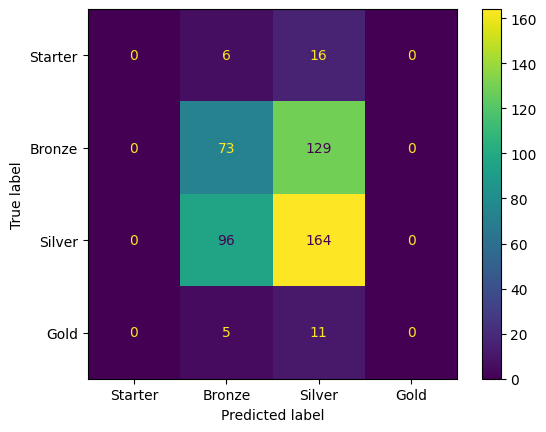

In [75]:
# Mostrar Matriz de confusão
confusion_matrix_model = confusion_matrix(y, y_pred, labels=segment_list)
disp = ConfusionMatrixDisplay(confusion_matrix_model, display_labels=segment_list)
disp.plot()

### Tuning de hiper-parametros

In [77]:
# Ajustar hiperparametros do modelo usando Optuna
# min_sample_leafs = Mínimo de instâncias (dados na base) requerido para formar uma folha (nó terminal)
# max_depth = Profundidade máxima da árvore

def decision_tree_optuna(trial):
  min_sample_leafs = trial.suggest_int('min_samples_leaf', 1, 20)
  max_depth = trial.suggest_int('max_depth', 2, 8)
  
  dt_model.set_params(classifier__min_samples_leaf=min_sample_leafs)
  dt_model.set_params(classifier__max_depth=max_depth)
  
  scores = cross_val_score(dt_model, X, y, cv=cv_folds, scoring='accuracy')
  
  return scores.mean()

In [87]:
# Executar a automação de execução de experimentos
decision_tree_study = optuna.create_study(direction='maximize')
decision_tree_study.optimize(decision_tree_optuna, n_trials=100)

[I 2024-10-29 00:05:38,575] A new study created in memory with name: no-name-8d927ec0-687f-4c02-8197-b8f020b07aa8
[I 2024-10-29 00:05:38,594] Trial 0 finished with value: 0.4699877353726283 and parameters: {'min_samples_leaf': 7, 'max_depth': 3}. Best is trial 0 with value: 0.4699877353726283.
[I 2024-10-29 00:05:38,610] Trial 1 finished with value: 0.45398359906692637 and parameters: {'min_samples_leaf': 8, 'max_depth': 4}. Best is trial 0 with value: 0.4699877353726283.
[I 2024-10-29 00:05:38,624] Trial 2 finished with value: 0.4739917754851743 and parameters: {'min_samples_leaf': 6, 'max_depth': 8}. Best is trial 2 with value: 0.4739917754851743.
[I 2024-10-29 00:05:38,636] Trial 3 finished with value: 0.4739917754851743 and parameters: {'min_samples_leaf': 10, 'max_depth': 7}. Best is trial 2 with value: 0.4739917754851743.
[I 2024-10-29 00:05:38,649] Trial 4 finished with value: 0.4699877353726283 and parameters: {'min_samples_leaf': 11, 'max_depth': 3}. Best is trial 2 with value

In [88]:
# Mostrar melhor resultado e melhor conjunto de hiperparâmetros
print(f'Melhor acurácia: {decision_tree_study.best_value}')
print(f'Melhores parâmetros: {decision_tree_study.best_params}')

Melhor acurácia: 0.4740518962075848
Melhores parâmetros: {'min_samples_leaf': 13, 'max_depth': 2}


### Visualizar árvore

In [89]:
# Preparar o conjunto de dados para treinar e conseguir visualizar a árvore
X_train_tree = X.copy()
X_train_tree['localizacao_label'] = X_train_tree.localizacao.astype('category').cat.codes
X_train_tree['atividade_economica_label'] = X_train_tree.atividade_economica.astype('category').cat.codes
X_train_tree.drop(columns=['localizacao', 'atividade_economica'], axis=1, inplace=True)
X_train_tree.rename(columns={'atividade_economica_label': 'atividade_economica', 'localizacao_label': 'localizacao'}, inplace=True)
X_train_tree.head(10)

,faturamento_mensal,numero_de_funcionarios,idade,inovacao,localizacao,atividade_economica
0,713109.95,12,6,1,1,1
1,790714.38,9,15,0,2,1
2,1197239.33,17,4,9,2,1
3,449185.78,15,6,0,2,2
4,1006373.16,15,15,8,2,0
5,1629562.41,16,11,4,1,3
6,771179.95,13,0,1,3,3
7,707837.61,16,10,6,2,3
8,888983.66,17,10,1,0,1
9,1098512.64,13,9,3,1,2


In [90]:
# Treinar o modelo com o conjunto de hiperparametros ideal
clf_decision_tree = DecisionTreeClassifier(
  min_samples_leaf=decision_tree_study.best_params['min_samples_leaf'],
  max_depth=decision_tree_study.best_params['max_depth'],
)

y_train_tree = y.copy()

clf_decision_tree.fit(X_train_tree, y_train_tree)

DecisionTreeClassifier(max_depth=2, min_samples_leaf=13)

[Text(0.5, 0.8333333333333334, 'inovacao <= 2.5\ngini = 0.563\nsamples = 500\nvalue = [202, 16, 260, 22]\nclass = Silver'),
 Text(0.25, 0.5, 'faturamento_mensal <= 425959.422\ngini = 0.482\nsamples = 165\nvalue = [112, 0, 35, 18]\nclass = Starter'),
 Text(0.375, 0.6666666666666667, 'True  '),
 Text(0.125, 0.16666666666666666, 'gini = 0.26\nsamples = 13\nvalue = [2, 0, 0, 11]\nclass = Gold'),
 Text(0.375, 0.16666666666666666, 'gini = 0.421\nsamples = 152\nvalue = [110, 0, 35, 7]\nclass = Starter'),
 Text(0.75, 0.5, 'faturamento_mensal <= 549601.438\ngini = 0.474\nsamples = 335\nvalue = [90.0, 16.0, 225.0, 4.0]\nclass = Silver'),
 Text(0.625, 0.6666666666666667, '  False'),
 Text(0.625, 0.16666666666666666, 'gini = 0.459\nsamples = 37\nvalue = [26, 0, 7, 4]\nclass = Starter'),
 Text(0.875, 0.16666666666666666, 'gini = 0.416\nsamples = 298\nvalue = [64.0, 16.0, 218.0, 0.0]\nclass = Silver')]

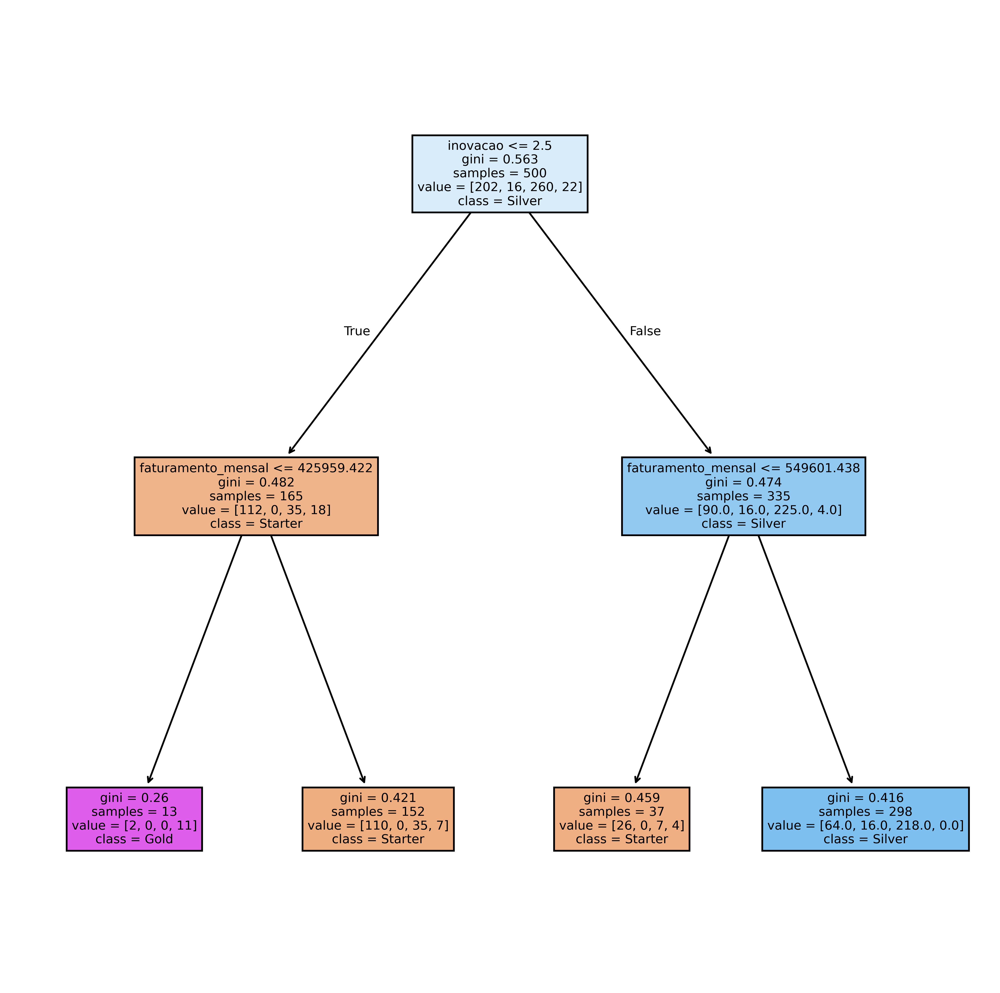

In [92]:
# Visualizar árovore de decisão
fix, axes = plt.subplots(nrows=1, ncols=1, figsize=(10,10), dpi=600)
plot_tree(
  clf_decision_tree,
  feature_names=X_train_tree.columns.to_numpy(), 
  class_names=segment_list,
  filled=True,
)

## Entrega do modelo

In [93]:
import joblib

In [95]:
# Criar pipeline com o modelo tunado
dt_model_tuned = Pipeline(steps=[
  ('preprocessor', preprocessor),
  ('classifier', DecisionTreeClassifier(
    min_samples_leaf=decision_tree_study.best_params['min_samples_leaf'],
  	max_depth=decision_tree_study.best_params['max_depth'],
  ))
])

# Treinar modelo tunado
dt_model_tuned.fit(X, y)

# Salvar modelo
joblib.dump(dt_model_tuned, 'classification_model_decision_tree.pkl')

['classification_model_decision_tree.pkl']

### Entregar modelo como App de batch por arquivo

In [96]:
import gradio as gr

model = joblib.load('./classification_model_decision_tree.pkl')

def predict(file):
	df_companies = pd.read_csv(file)
	y_pred = model.predict(df_companies)
	df_segments = pd.DataFrame(y_pred, columns=['segmento_do_cliente'])
	df_predictions = pd.concat([df_companies, df_segments], axis=1)
	df_predictions.to_csv('./predictions.csv', index=False)
	return './predictions.csv'

demo = gr.Interface(
	predict,
	gr.File(file_types=['.csv']),
	"file"
)

demo.launch()

Running on local URL:  http://127.0.0.1:7860

To create a public link, set `share=True` in `launch()`.
